#Mini Project 3

## Install Packages

In [ ]:
!pip install quickda

In [ ]:
pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [ ]:
import pandas as pd
pd.get_option("display.max_columns")
pd.set_option("display.max_columns", None)
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
df = pd.read_csv('marketing_campaign_data.csv')

In [ ]:
df1 = df.copy()

## Data Prepocessing

### Melihat Value tiap kolom

In [ ]:
for column in df1:
  print(f'''value count: {column}''')
  print(df[column].value_counts())
  print()

value count: Unnamed: 0
0       1
1496    1
1490    1
1491    1
1492    1
       ..
740     1
739     1
738     1
737     1
2239    1
Name: Unnamed: 0, Length: 2240, dtype: int64

value count: ID
5524    1
6885    1
3478    1
7494    1
1763    1
       ..
5682    1
5564    1
6516    1
6255    1
9405    1
Name: ID, Length: 2240, dtype: int64

value count: Year_Birth
1976    89
1971    87
1975    83
1972    79
1978    77
1970    77
1973    74
1965    74
1969    71
1974    69
1956    55
1958    53
1979    53
1952    52
1977    52
1968    51
1959    51
1966    50
1954    50
1955    49
1960    49
1982    45
1963    45
1967    44
1962    44
1957    43
1951    43
1983    42
1986    42
1964    42
1980    39
1981    39
1984    38
1961    36
1953    35
1985    32
1989    30
1949    30
1950    29
1988    29
1987    27
1948    21
1990    18
1946    16
1947    16
1991    15
1992    13
1945     8
1943     7
1944     7
1993     5
1995     5
1994     3
1996     2
1899     1
1941     1
1893     1
1900 

In [ ]:
df1.isnull().sum()

Unnamed: 0              0
ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntCoke                 0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

### Feature Engineering

In [ ]:
df1['total_purchase'] = df1['NumCatalogPurchases'] + df1['NumDealsPurchases'] + df1['NumStorePurchases'] + df1['NumWebPurchases']
df1.head()

,Unnamed: 0,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntCoke,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,total_purchase
0,0,5524,1957,S1,Lajang,58138000.000,0,0,04-09-2012,58,635000,88000,546000,172000,88000,88000,3,8,10,4,7,0,0,0,0,0,0,3,11,1,25
1,1,2174,1954,S1,Lajang,46344000.000,1,1,08-03-2014,38,11000,1000,6000,2000,1000,6000,2,1,1,2,5,0,0,0,0,0,0,3,11,0,6
2,2,4141,1965,S1,Bertunangan,71613000.000,0,0,21-08-2013,26,426000,49000,127000,111000,21000,42000,1,8,2,10,4,0,0,0,0,0,0,3,11,0,21
3,3,6182,1984,S1,Bertunangan,26646000.000,1,0,10-02-2014,26,11000,4000,20000,10000,3000,5000,2,2,0,4,6,0,0,0,0,0,0,3,11,0,8
4,4,5324,1981,S3,Menikah,58293000.000,1,0,19-01-2014,94,173000,43000,118000,46000,27000,15000,5,5,3,6,5,0,0,0,0,0,0,3,11,0,19


In [ ]:
def rate(x,y):
  if y == 0:
    return 0
  return x/y 

In [ ]:
df1['cnv_rate'] = df1.apply(lambda x : rate(x['total_purchase'], x['NumWebVisitsMonth']),axis=1)
a = df1['cnv_rate']
a.sort_values(ascending=False)

21     43.000
1653   28.000
878    28.000
426    27.000
84     27.000
        ...  
1806    0.000
687     0.000
1955    0.000
655     0.000
975     0.000
Name: cnv_rate, Length: 2240, dtype: float64

In [ ]:
df1['umur'] = 2022 - df1['Year_Birth']
df1['umur']

0       65
1       68
2       57
3       38
4       41
        ..
2235    55
2236    76
2237    41
2238    66
2239    68
Name: umur, Length: 2240, dtype: int64

In [ ]:
df1['total_spend'] = df1['MntCoke'] + df1['MntFishProducts'] + df1['MntFruits'] + df1['MntGoldProds'] + df1['MntMeatProducts'] + df1['MntSweetProducts']
df1['total_spend']

0       1617000
1         27000
2        776000
3         53000
4        422000
         ...   
2235    1341000
2236     444000
2237    1241000
2238     843000
2239     172000
Name: total_spend, Length: 2240, dtype: int64

In [ ]:
df1['campaign'] = df1['AcceptedCmp1'] + df1['AcceptedCmp2'] + df1['AcceptedCmp3'] + df1['AcceptedCmp4'] + df1['AcceptedCmp5']
df1['campaign']

0       0
1       0
2       0
3       0
4       0
       ..
2235    0
2236    1
2237    1
2238    0
2239    0
Name: campaign, Length: 2240, dtype: int64

In [ ]:
import pandas_profiling as pp
from pandas_profiling import ProfileReport
profile = ProfileReport(df1, title="Pandas Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
median = df1['Income'].median()
df1['Income'].fillna(median,inplace=True)

In [ ]:
df1.isnull().sum()

Unnamed: 0             0
ID                     0
Year_Birth             0
Education              0
Marital_Status         0
Income                 0
Kidhome                0
Teenhome               0
Dt_Customer            0
Recency                0
MntCoke                0
MntFruits              0
MntMeatProducts        0
MntFishProducts        0
MntSweetProducts       0
MntGoldProds           0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
AcceptedCmp3           0
AcceptedCmp4           0
AcceptedCmp5           0
AcceptedCmp1           0
AcceptedCmp2           0
Complain               0
Z_CostContact          0
Z_Revenue              0
Response               0
total_purchase         0
cnv_rate               0
umur                   0
total_spend            0
campaign               0
dtype: int64

In [ ]:
bin =[0,26,40,60,80,130]
df1['umur_bin'] = pd.cut(df1['umur'],bin)
df1['umur_bin']

0       (60, 80]
1       (60, 80]
2       (40, 60]
3       (26, 40]
4       (40, 60]
          ...   
2235    (40, 60]
2236    (60, 80]
2237    (40, 60]
2238    (60, 80]
2239    (60, 80]
Name: umur_bin, Length: 2240, dtype: category
Categories (5, interval[int64, right]): [(0, 26] < (26, 40] < (40, 60] < (60, 80] < (80, 130]]

In [ ]:
#create total of days joined
import datetime as dt
from datetime import date

df1['Dt_Customer'] = pd.to_datetime(df1['Dt_Customer'])
df1['Dt_Collected'] = date.today()
df1['Dt_Collected'] = df1['Dt_Collected'].astype('datetime64[ns]')
df1['Dt_Days_Customer'] = df1['Dt_Collected'] - df1['Dt_Customer']
df1['Dt_Days_Customer'] = df1['Dt_Days_Customer'].dt.days

In [ ]:
def child(x,y):
  if x == 0 or y == 0:
    return 0
  return 1

In [ ]:
df1['child'] = df1.apply(lambda x : child(x['Kidhome'], x['Teenhome']), axis=1)

In [ ]:
df1.info

<bound method DataFrame.info of       Unnamed: 0     ID  Year_Birth Education Marital_Status       Income  \
0              0   5524        1957        S1         Lajang 58138000.000   
1              1   2174        1954        S1         Lajang 46344000.000   
2              2   4141        1965        S1    Bertunangan 71613000.000   
3              3   6182        1984        S1    Bertunangan 26646000.000   
4              4   5324        1981        S3        Menikah 58293000.000   
...          ...    ...         ...       ...            ...          ...   
2235        2235  10870        1967        S1        Menikah 61223000.000   
2236        2236   4001        1946        S3    Bertunangan 64014000.000   
2237        2237   7270        1981        S1          Cerai 56981000.000   
2238        2238   8235        1956        S2    Bertunangan 69245000.000   
2239        2239   9405        1954        S3        Menikah 52869000.000   

      Kidhome  Teenhome Dt_Customer  Recenc

### Drop Unused Column

In [ ]:
df1.drop(columns=['Unnamed: 0', 'ID','MntCoke','MntFruits', 'MntMeatProducts', 'MntFishProducts',
                  'MntSweetProducts','MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
                  'NumCatalogPurchases', 'NumStorePurchases','AcceptedCmp3', 'AcceptedCmp4', 
                  'AcceptedCmp5', 'AcceptedCmp1','AcceptedCmp2','Z_CostContact', 'Z_Revenue'],inplace=True)

In [ ]:
df1.columns

Index(['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'NumWebVisitsMonth', 'Complain',
       'Response', 'total_purchase', 'cnv_rate', 'umur', 'total_spend',
       'campaign', 'umur_bin', 'Dt_Collected', 'Dt_Days_Customer', 'child'],
      dtype='object')

### Drop Duplicated Values

In [ ]:
print('total baris sebelum handling duplikat:\n',df1.shape)

total baris sebelum handling duplikat:
 (2057, 20)


In [ ]:
print('data yang duplikat sebanyak:\n',df1.duplicated().sum())

data yang duplikat sebanyak:
 0


## EDA

### Splitting Data Based on Dtypes

In [ ]:
df_num = df1.select_dtypes(include=np.number)
df_cat = df1.select_dtypes(include='object')
df_num.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2057 entries, 0 to 2239
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Year_Birth         2057 non-null   int64  
 1   Income             2057 non-null   float64
 2   Kidhome            2057 non-null   int64  
 3   Teenhome           2057 non-null   int64  
 4   Recency            2057 non-null   int64  
 5   NumWebVisitsMonth  2057 non-null   int64  
 6   Complain           2057 non-null   int64  
 7   Z_CostContact      2057 non-null   int64  
 8   Z_Revenue          2057 non-null   int64  
 9   Response           2057 non-null   int64  
 10  total_purchase     2057 non-null   int64  
 11  cnv_rate           2057 non-null   float64
 12  umur               2057 non-null   int64  
 13  total_spend        2057 non-null   int64  
 14  campaign           2057 non-null   int64  
 15  Dt_Days_Customer   2057 non-null   int64  
 16  child              2057 

### Scatter Plot of Each Columns Based on Conversion Rate

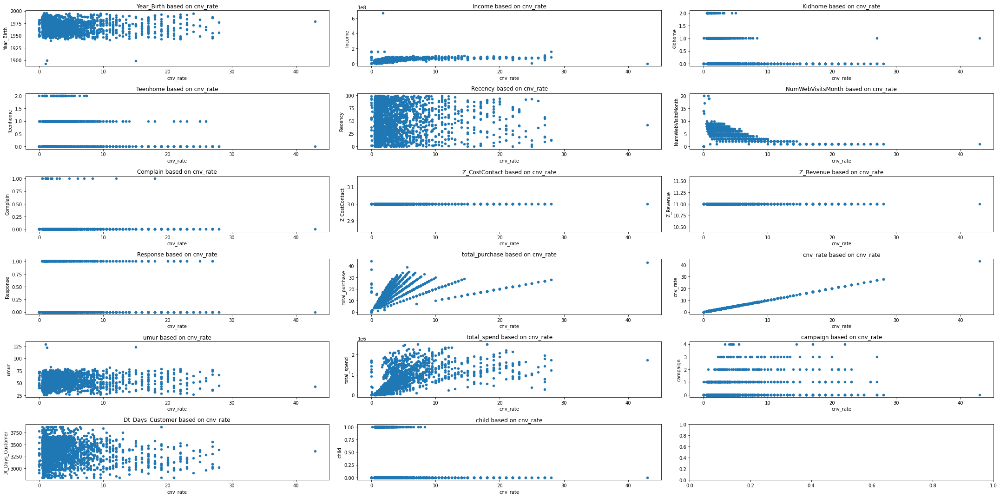

In [ ]:
f,ax = plt.subplots(6,3,figsize=(30,15))
axe = ax.ravel()
for i,c in enumerate(df_num.columns):
  df_num.plot(kind='scatter',x='cnv_rate',y=c ,ax=axe[i],title='{} based on cnv_rate'.format(c))
plt.tight_layout()

## Encode Categorical Values

In [ ]:
encode = pd.get_dummies(df1,columns=['Education', 'Marital_Status'],drop_first= True)
print(encode)

      Year_Birth       Income  Kidhome  Teenhome Dt_Customer  Recency  \
0           1957   58138000.0        0         0  2012-04-09       58   
1           1954   46344000.0        1         1  2014-08-03       38   
2           1965   71613000.0        0         0  2013-08-21       26   
3           1984   26646000.0        1         0  2014-10-02       26   
4           1981   58293000.0        1         0  2014-01-19       94   
...          ...          ...      ...       ...         ...      ...   
2233        1977  666666000.0        1         0  2013-02-06       23   
2235        1967   61223000.0        0         1  2013-06-13       46   
2237        1981   56981000.0        0         0  2014-01-25       91   
2238        1956   69245000.0        0         1  2014-01-24        8   
2239        1954   52869000.0        1         1  2012-10-15       40   

      NumWebVisitsMonth  Complain  Z_CostContact  Z_Revenue  Response  \
0                     7         0              3  

In [ ]:
encode

,Year_Birth,Income,Kidhome,Teenhome,Dt_Customer,Recency,NumWebVisitsMonth,Complain,Z_CostContact,Z_Revenue,Response,total_purchase,cnv_rate,umur,total_spend,campaign,umur_bin,Dt_Collected,Dt_Days_Customer,child,Education_S1,Education_S2,Education_S3,Education_SMA,Marital_Status_Cerai,Marital_Status_Duda,Marital_Status_Janda,Marital_Status_Lajang,Marital_Status_Menikah
0,1957,58138000.0,0,0,2012-04-09,58,7,0,3,11,1,25,3.571429,65,1617000,0,"(60, 80]",2022-08-14,3779,0,1,0,0,0,0,0,0,1,0
1,1954,46344000.0,1,1,2014-08-03,38,5,0,3,11,0,6,1.200000,68,27000,0,"(60, 80]",2022-08-14,2933,1,1,0,0,0,0,0,0,1,0
2,1965,71613000.0,0,0,2013-08-21,26,4,0,3,11,0,21,5.250000,57,776000,0,"(40, 60]",2022-08-14,3280,0,1,0,0,0,0,0,0,0,0
3,1984,26646000.0,1,0,2014-10-02,26,6,0,3,11,0,8,1.333333,38,53000,0,"(26, 40]",2022-08-14,2873,0,1,0,0,0,0,0,0,0,0
4,1981,58293000.0,1,0,2014-01-19,94,5,0,3,11,0,19,3.800000,41,422000,0,"(40, 60]",2022-08-14,3129,0,0,0,1,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2233,1977,666666000.0,1,0,2013-02-06,23,6,0,3,11,0,11,1.833333,45,62000,0,"(40, 60]",2022-08-14,3476,0,1,0,0,0,0,0,0,0,0
2235,1967,61223000.0,0,1,2013-06-13,46,5,0,3,11,0,18,3.600000,55,1341000,0,"(40, 60]",2022-08-14,3349,0,1,0,0,0,0,0,0,0,1
2237,1981,56981000.0,0,0,2014-01-25,91,6,0,3,11,0,19,3.166667,41,1241000,1,"(40, 60]",2022-08-14,3123,0,1,0,0,0,1,0,0,0,0
2238,1956,69245000.0,0,1,2014-01-24,8,3,0,3,11,0,23,7.666667,66,843000,0,"(60, 80]",2022-08-14,3124,0,0,1,0,0,0,0,0,0,0


## Reduce Dimensionality

RFM Analysis to reduce dimensionality

R (Recency) = Recency

F (Frequency) = Total_Purchase

M (Monetary) = total_spend

L = Dt_Days_Customer

C = Umur

In [ ]:
encode1 =encode[['Recency','total_purchase','total_spend','Dt_Days_Customer','umur']]
encode1.columns = ['R', 'F', 'M','L','C']
encode1.describe()

,R,F,M,L,C
count,2057.000000,2057.000000,2.057000e+03,2057.000000,2057.000000
mean,48.974234,14.867282,6.063291e+05,3319.035489,53.214876
std,28.988523,7.664752,6.029714e+05,232.497365,11.976449
min,0.000000,0.000000,5.000000e+03,2808.000000,26.000000
25%,24.000000,8.000000,6.900000e+04,3147.000000,45.000000
50%,49.000000,15.000000,3.960000e+05,3319.000000,52.000000
75%,74.000000,21.000000,1.047000e+06,3492.000000,63.000000
max,99.000000,44.000000,2.525000e+06,3871.000000,129.000000


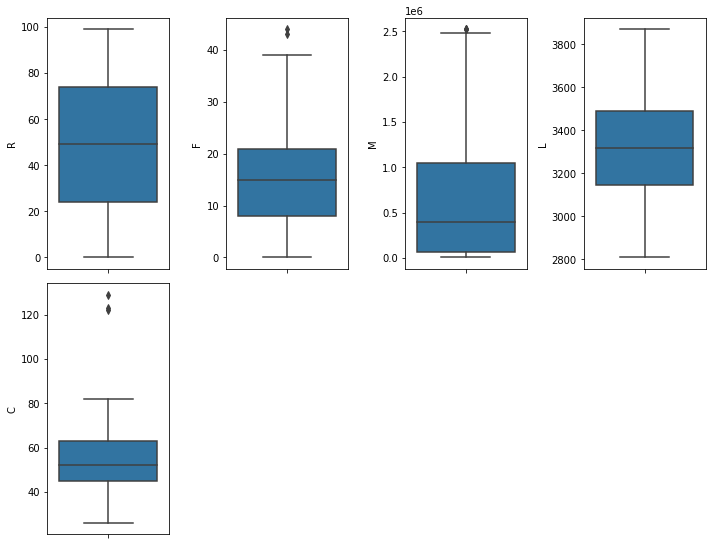

In [ ]:
import seaborn as sns
cols = encode1.columns
plt.figure(figsize= (10,15))
for i in range(len(cols)):
    plt.subplot(4, 4, i+1)
    sns.boxplot(y = encode1[cols[i]], orient='v')
    plt.tight_layout()

In [ ]:
encode1.shape

(2057, 5)

In [ ]:
encode_z = encode1.copy()

In [ ]:
from scipy import stats
import numpy as np
z = np.abs(stats.zscore(encode_z))
filter = (z<3).all(axis=1)
encode_z = encode_z[filter]
encode_z

,R,F,M,L,C
0,58,25,1617000,3779,65
1,38,6,27000,2933,68
2,26,21,776000,3280,57
3,26,8,53000,2873,38
4,94,19,422000,3129,41
...,...,...,...,...,...
2233,23,11,62000,3476,45
2235,46,18,1341000,3349,55
2237,91,19,1241000,3123,41
2238,8,23,843000,3124,66


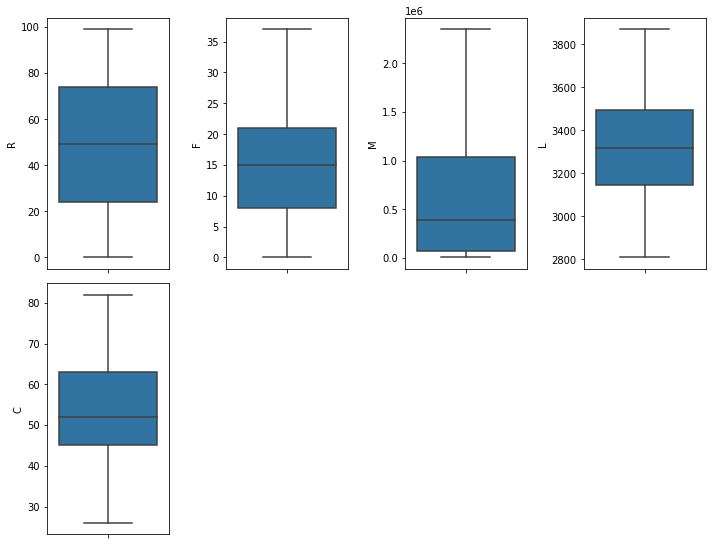

In [ ]:
import seaborn as sns
cols = encode_z.columns
plt.figure(figsize= (10,15))
for i in range(len(cols)):
    plt.subplot(4, 4, i+1)
    sns.boxplot(y = encode_z[cols[i]], orient='v')
    plt.tight_layout()

## Evaluation and Modelling

### Scaling

In [ ]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
col_name = list(encode_z.columns)
new_encode = encode_z.copy()
scaler = MinMaxScaler()
new_encode = scaler.fit_transform(encode_z.values)
new_encode = pd.DataFrame(new_encode,columns=col_name)

In [ ]:
new_encode.sample(5)

,R,F,M,L,C
195,0.818182,0.405405,0.109928,0.235183,0.410714
808,0.303030,0.540541,0.322113,0.244591,0.339286
62,0.080808,0.513514,0.256072,0.371590,0.803571
1403,0.868687,0.216216,0.029825,0.365945,0.107143
1354,0.161616,0.108108,0.010652,0.639699,0.178571


In [ ]:
pd.set_option('display.float_format', lambda x: '%.3f' % x)
new_encode.describe()

,R,F,M,L,C
count,2046.000,2046.000,2046.000,2046.000,2046.000
mean,0.495,0.400,0.254,0.481,0.485
std,0.293,0.205,0.254,0.219,0.208
min,0.000,0.000,0.000,0.000,0.000
25%,0.242,0.216,0.027,0.319,0.339
50%,0.495,0.405,0.166,0.482,0.464
75%,0.747,0.568,0.440,0.644,0.661
max,1.000,1.000,1.000,1.000,1.000


### Elbow Methods

In [ ]:
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
from sklearn.metrics import silhouette_score

In [ ]:
inertias = []
silhouette = []
mapping1 = {}
mapping2 = {}
K = range(2, 10)
  
for k in K:
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k).fit(new_encode)
    kmeanModel.fit(new_encode)
    score = silhouette_score(new_encode, kmeanModel.labels_)
    inertias.append(kmeanModel.inertia_)
    silhouette.append(score)

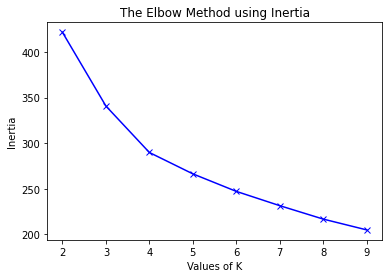

In [ ]:
plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

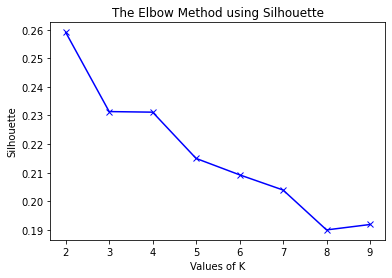

In [ ]:
plt.plot(K, silhouette, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Silhouette')
plt.title('The Elbow Method using Silhouette')
plt.show()

In [ ]:
pip install kneed

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from kneed import KneeLocator
kl_i = KneeLocator(K,inertias,curve="convex", direction="decreasing")

In [ ]:
kl_i.elbow

4

In [ ]:
df_std_cluster = new_encode.copy()
df_cluster = encode_z.copy()
kmeans = KMeans(n_clusters=4, random_state=24).fit(new_encode)
df_std_cluster['clusters'] = kmeans.labels_
df_cluster['clusters'] = kmeans.labels_

In [ ]:
df_std_cluster.shape

(2046, 6)

In [ ]:
df_cluster.shape

(2046, 6)

### PCA

In [ ]:
from sklearn.decomposition import PCA 
pca = PCA(n_components=2)
pca.fit(new_encode)
pcs = pca.transform(new_encode)

df_pca = pd.DataFrame(data = pcs, columns = ['PC 1', 'PC 2'])
df_pca['clusters'] = df_std_cluster['clusters']
df_pca

,PC 1,PC 2,clusters
0,0.631,-0.028,2
1,-0.370,0.072,0
2,0.129,0.252,1
3,-0.452,0.195,0
4,-0.014,-0.449,3
...,...,...,...
2041,-0.257,0.226,0
2042,0.296,0.068,1
2043,0.244,-0.384,2
2044,0.155,0.442,1


### Insights

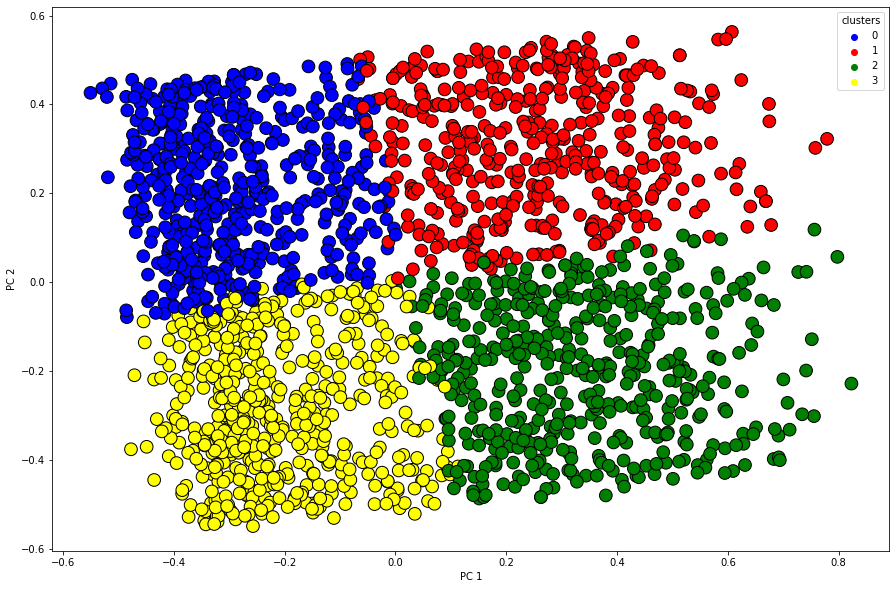

In [ ]:
fig, ax = plt.subplots(figsize=(15,10))

sns.scatterplot(
    x="PC 1", y="PC 2",
    hue="clusters",
    edgecolor='black',
    #linestyle='--',
    data=df_pca,
    palette=['blue','red','green','yellow'],
    s=160,
    ax=ax
)

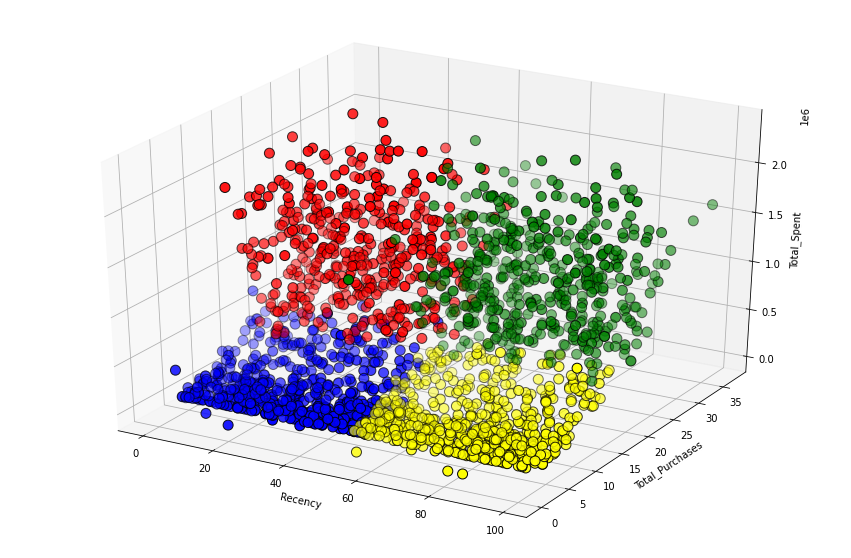

In [ ]:
fig = plt.figure(figsize=(15,10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(df_cluster['R'][df_cluster.clusters == 0], df_cluster['F'][df_cluster.clusters == 0], df_cluster['M'][df_cluster.clusters == 0], c='blue', s=100, edgecolor='black')
ax.scatter(df_cluster['R'][df_cluster.clusters == 1], df_cluster['F'][df_cluster.clusters == 1], df_cluster['M'][df_cluster.clusters == 1], c='red', s=100, edgecolor='black')
ax.scatter(df_cluster['R'][df_cluster.clusters == 2], df_cluster['F'][df_cluster.clusters == 2], df_cluster['M'][df_cluster.clusters == 2], c='green', s=100, edgecolor='black')
ax.scatter(df_cluster['R'][df_cluster.clusters == 3], df_cluster['F'][df_cluster.clusters == 3], df_cluster['M'][df_cluster.clusters == 3], c='yellow', s=100, edgecolor='black')


plt.xlabel('Recency')
plt.ylabel('Total_Purchases')
ax.set_zlabel('Total_Spent')
plt.show()

In [ ]:
display(df_cluster.groupby('clusters').agg(['mean','median']))

R             F                  M                    L  \
           mean median   mean median        mean      median     mean   
clusters                                                                
0        24.526 25.000  8.770  8.000  134926.391   69000.000 3273.115   
1        22.348 23.000 21.780 21.000 1115991.131 1071000.000 3357.477   
2        72.842 72.000 21.508 21.500 1166907.787 1113000.000 3366.178   
3        74.378 75.000  9.293  8.000  146060.000   84000.000 3292.527   

                       C         
           median   mean median  
clusters                         
0        3258.000 50.039 49.000  
1        3379.000 54.625 54.000  
2        3376.000 56.453 57.000  
3        3283.500 52.131 51.000

In [ ]:
df_tc = df_cluster.groupby('clusters').agg({'R':'count'}).reset_index()
df_tc = df_tc.rename(columns={'R':'Total Customers'})
df_tc

,clusters,Total Customers
0,0,557
1,1,451
2,2,488
3,3,550


## Business Recommendation

Priority Customers (Cluster 1) = Customer with high value in all three factor on RFM analysis. Customer with recent activities on marketplace, high frequencies of purchase and high spending on marketplace should be targeted with special promotions like triggered campaigns or free shipping fee to keep them active

New Customers (Cluster 0) = Customers with recent activities but low frequencies of purchase maybe a new customers. A targeted follow-up like events, promotion or new product may convert them into repeat customer

Old Customers (Cluster 2 and 3) = Customers with no recent activities but high spending were once valueable customers but have stopped either because competitor or any other reasons such as poor experience or dissatisfied with product or service. Identify the problem and work on it. A targeted message like 'we fix it' campaign that explain the marketplace listened to customer feedback to make a better experience on our marketplace may reactivate them